In [1]:
import os
import numpy as np
from PIL import Image
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Dropout, concatenate, Conv2DTranspose
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from tensorflow.keras import backend as K
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Polygon
import rasterio
from rasterio.features import shapes
import ezdxf
import traceback

# Chemins d'accès aux répertoires des données (à adapter selon votre structure de dossiers)
train_images_dir = r'D:\oujda\AerialImageDataset\train\images'
train_masks_dir = r'D:\oujda\AerialImageDataset\train\mask'

In [2]:
def load_and_resize_images(directory, target_size=(512, 512), color_mode='rgb'):
    if not os.path.exists(directory):
        raise FileNotFoundError(f"Le répertoire {directory} n'existe pas")

    image_list = []
    for filename in os.listdir(directory):
        if filename.endswith(".tif"):
            with rasterio.open(os.path.join(directory, filename)) as src:
                img = src.read()
                if color_mode == 'rgb':
                    img = np.transpose(img[:3], (1, 2, 0))  # Prendre les 3 premières bandes pour RGB
                elif color_mode == 'grayscale':
                    img = img[0]  # Prendre la première bande pour le niveau de gris
                img = Image.fromarray(img)
                img = img.resize(target_size)
                img_array = np.array(img)
                image_list.append(img_array)

    print(f"Chargé et redimensionné {len(image_list)} images depuis {directory}")
    return np.array(image_list)

# Métriques d'évaluation
smooth = 1

def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(K.cast(y_true, 'float32'))
    y_pred_f = K.flatten(K.cast(y_pred, 'float32'))
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def dice_coef_loss(y_true, y_pred):
    return 1. - dice_coef(y_true, y_pred)

In [3]:
def unet(input_size=(512, 512, 3)):
    inputs = Input(input_size)

    # Encodeur
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(512, 3, activation='relu', padding='same')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    # Pont
    conv5 = Conv2D(1024, 3, activation='relu', padding='same')(pool4)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same')(conv5)
    drop5 = Dropout(0.5)(conv5)

    # Décodeur
    up6 = Conv2DTranspose(512, 2, strides=(2, 2), padding='same')(drop5)
    merge6 = concatenate([drop4, up6], axis=3)
    conv6 = Conv2D(512, 3, activation='relu', padding='same')(merge6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same')(conv6)

    up7 = Conv2DTranspose(256, 2, strides=(2, 2), padding='same')(conv6)
    merge7 = concatenate([conv3, up7], axis=3)
    conv7 = Conv2D(256, 3, activation='relu', padding='same')(merge7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same')(conv7)

    up8 = Conv2DTranspose(128, 2, strides=(2, 2), padding='same')(conv7)
    merge8 = concatenate([conv2, up8], axis=3)
    conv8 = Conv2D(128, 3, activation='relu', padding='same')(merge8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same')(conv8)

    up9 = Conv2DTranspose(64, 2, strides=(2, 2), padding='same')(conv8)
    merge9 = concatenate([conv1, up9], axis=3)
    conv9 = Conv2D(64, 3, activation='relu', padding='same')(merge9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same')(conv9)

    conv10 = Conv2D(1, 1, activation='sigmoid')(conv9)

    model = Model(inputs=inputs, outputs=conv10)
    model.compile(optimizer=Adam(learning_rate=1e-4), loss='binary_crossentropy', metrics=[dice_coef])
    return model

In [4]:
def create_building_polygons(prediction, transform):
    mask = prediction[0, :, :, 0] > 0.5
    results = (
        {'properties': {'raster_val': v}, 'geometry': s}
        for i, (s, v) in enumerate(shapes(mask.astype(np.uint8), mask=mask, transform=transform))
    )
    geoms = list(results)

    # Filtrer les géométries non valides
    valid_geoms = [geom for geom in geoms if geom['geometry'] is not None]

    return valid_geoms

def create_dxf(geoms, output_path):
    doc = ezdxf.new('R2010')  # Créer un nouveau document DXF
    msp = doc.modelspace()  # Obtenir l'espace modèle

    for geom in geoms:
        if isinstance(geom['geometry'], dict):  # Si la géométrie est un dictionnaire
            if geom['geometry']['type'] == 'Polygon':
                coordinates = geom['geometry']['coordinates'][0]  # Prendre le premier anneau (extérieur)
                msp.add_lwpolyline(coordinates)
        elif hasattr(geom['geometry'], 'geom_type'):  # Si c'est un objet Shapely
            if geom['geometry'].geom_type == 'Polygon':
                points = list(geom['geometry'].exterior.coords)
                msp.add_lwpolyline(points)

    doc.saveas(output_path)

In [5]:
def predict_and_create_map(model, image_path):
    try:
        print(f"Début du traitement pour : {image_path}")

        with rasterio.open(image_path) as src:
            image = src.read().transpose(1, 2, 0)
            transform = src.transform

            # Prétraiter l'image pour le modèle
            original_shape = image.shape
            resized_image = Image.fromarray(image.astype(np.uint8))
            resized_image = resized_image.resize((512, 512))
            input_image = np.array(resized_image).astype('float32') / 255.0
            input_image = np.expand_dims(input_image, axis=0)

            # Faire la prédiction
            prediction = model.predict(input_image)

            # Redimensionner la prédiction à la taille originale
            pred_resized = np.array(
                Image.fromarray(prediction[0, :, :, 0]).resize((original_shape[1], original_shape[0])))
            pred_resized = np.expand_dims(np.expand_dims(pred_resized, axis=0), axis=-1)

            # Créer des polygones à partir de la prédiction redimensionnée
            geoms = create_building_polygons(pred_resized, transform)
            print(f"Nombre de géométries créées : {len(geoms)}")

            if len(geoms) == 0:
                print("Aucune géométrie n'a été créée. Vérifiez la prédiction.")
                return

            # Créer un GeoDataFrame
            gdf = gpd.GeoDataFrame.from_features(geoms)
            gdf.crs = src.crs

            # Créer la carte
            fig, ax = plt.subplots(figsize=(12, 12))

            # Afficher l'image de fond
            extent = [src.bounds.left, src.bounds.right, src.bounds.bottom, src.bounds.top]
            ax.imshow(image[:, :, :3], extent=extent)

            # Afficher les polygones des bâtiments
            gdf.plot(ax=ax, facecolor='none', edgecolor='red')

            ax.set_title("Carte des bâtiments détectés")
            ax.set_axis_off()
            plt.show()

            # Enregistrer les polygones en tant que fichier DXF
            output_dxf = os.path.splitext(image_path)[0] + '.dxf'
            create_dxf(geoms, output_dxf)
            print(f"Carte DXF créée : {output_dxf}")

            print("Traitement terminé avec succès.")
    except Exception as e:
        print(f"Erreur lors du traitement de l'image : {image_path}")
        print(str(e))
        traceback.print_exc()

Chargé et redimensionné 10 images depuis D:\oujda\AerialImageDataset\train\images
Chargé et redimensionné 10 images depuis D:\oujda\AerialImageDataset\train\mask


Epoch 1/2


2/2 [==============================] - ETA: 0s - loss: 0.6944 - dice_coef: 0.2198 
Epoch 1: val_dice_coef improved from -inf to 0.19161, saving model to D:\oujda\model_checkpoint.keras
2/2 [==============================] - 76s 46s/step - loss: 0.6944 - dice_coef: 0.2198 - val_loss: 0.6879 - val_dice_coef: 0.1916
Epoch 2/2
2/2 [==============================] - ETA: 0s - loss: 0.6863 - dice_coef: 0.2189 
Epoch 2: val_dice_coef did not improve from 0.19161
2/2 [==============================] - 66s 32s/step - loss: 0.6863 - dice_coef: 0.2189 - val_loss: 0.6797 - val_dice_coef: 0.1910
Début du traitement pour : D:\oujda\AerialImageDataset\test\images\bellingham1.tif
1/1 [==============================] - 2s 2s/step
Nombre de géométries créées : 1781


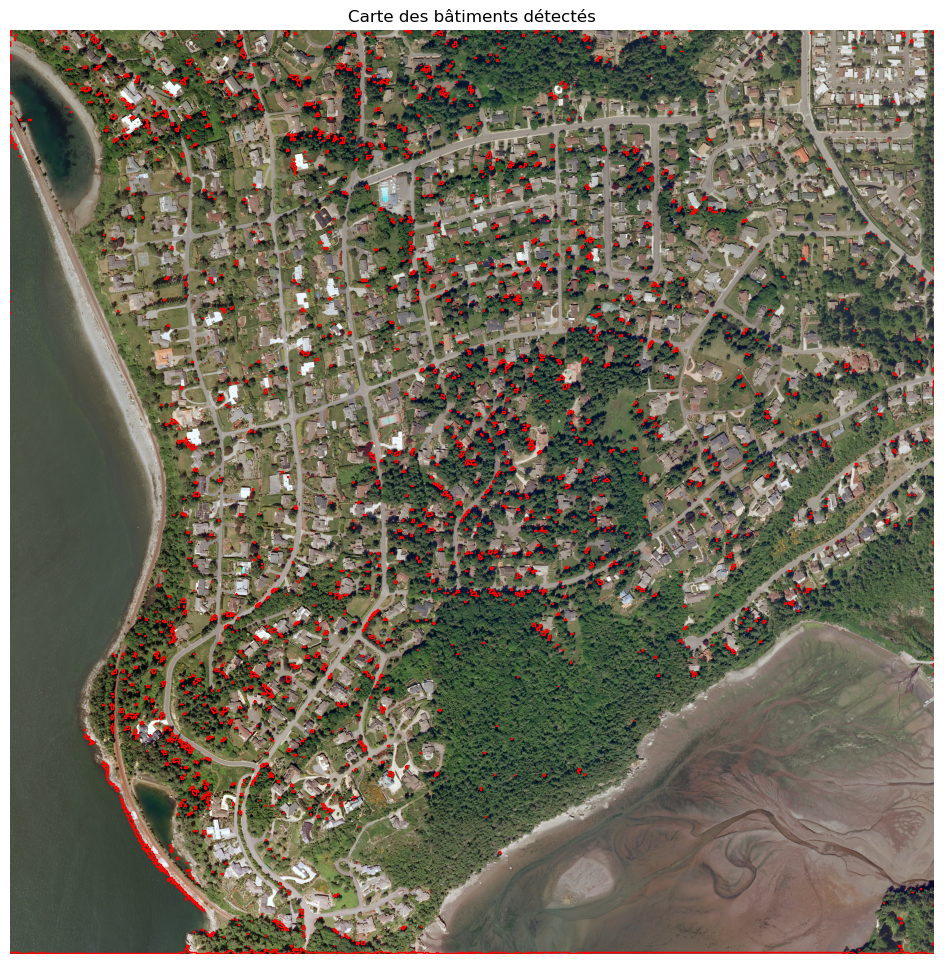

Carte DXF créée : D:\oujda\AerialImageDataset\test\images\bellingham1.dxf
Traitement terminé avec succès.
Début du traitement pour : D:\oujda\AerialImageDataset\test\images\bellingham2.tif
1/1 [==============================] - 1s 1s/step
Nombre de géométries créées : 1770


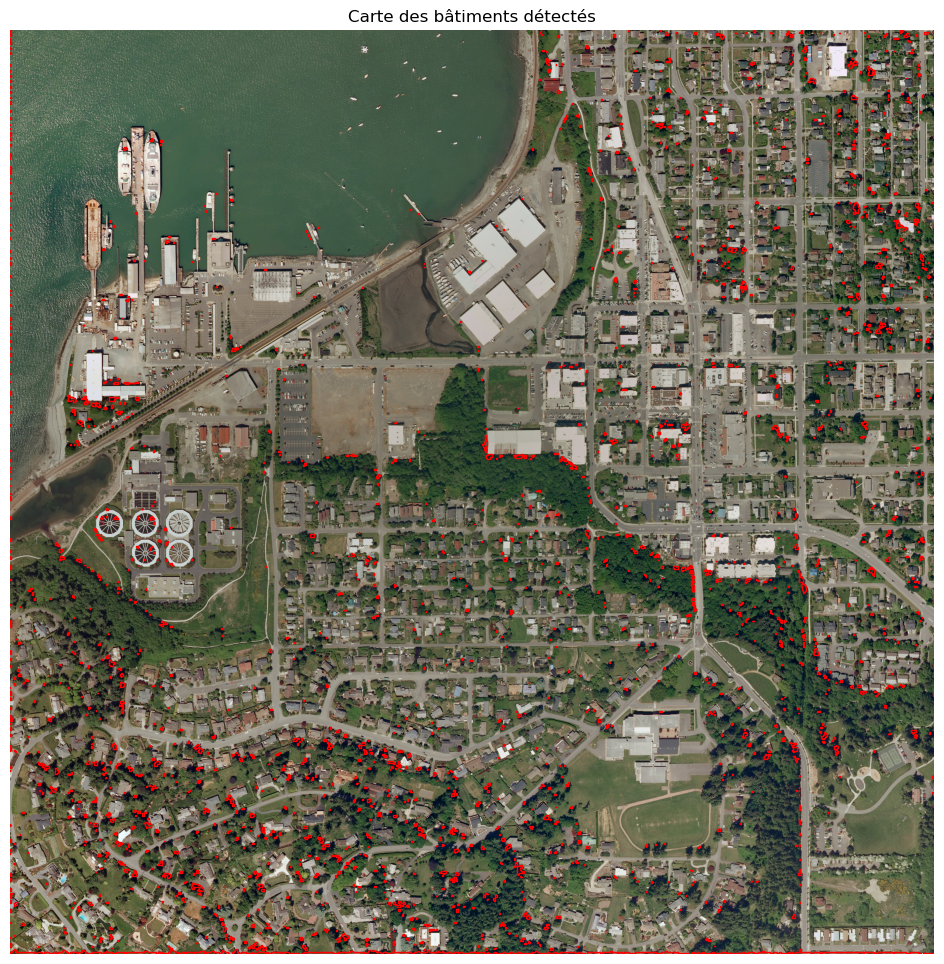

Carte DXF créée : D:\oujda\AerialImageDataset\test\images\bellingham2.dxf
Traitement terminé avec succès.
Début du traitement pour : D:\oujda\AerialImageDataset\test\images\bellingham3.tif
1/1 [==============================] - 1s 1s/step
Nombre de géométries créées : 1193


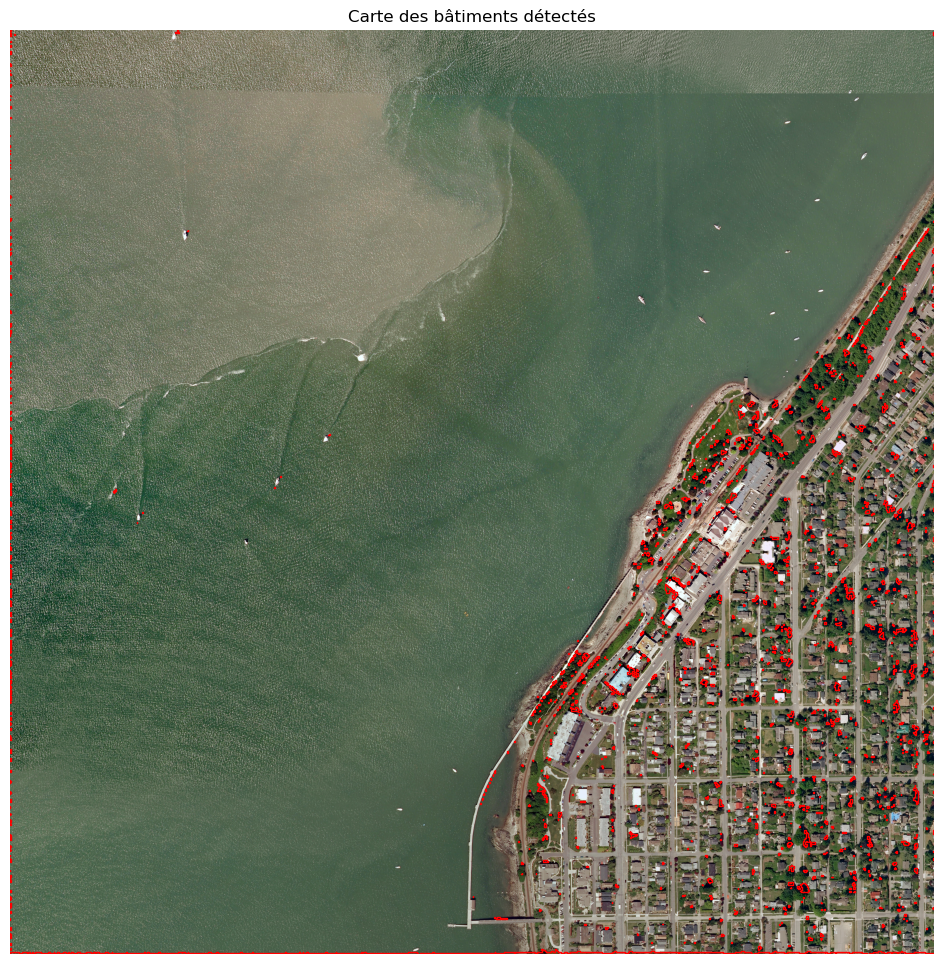

Carte DXF créée : D:\oujda\AerialImageDataset\test\images\bellingham3.dxf
Traitement terminé avec succès.
Début du traitement pour : D:\oujda\AerialImageDataset\test\images\bellingham4.tif
1/1 [==============================] - 2s 2s/step
Nombre de géométries créées : 1189


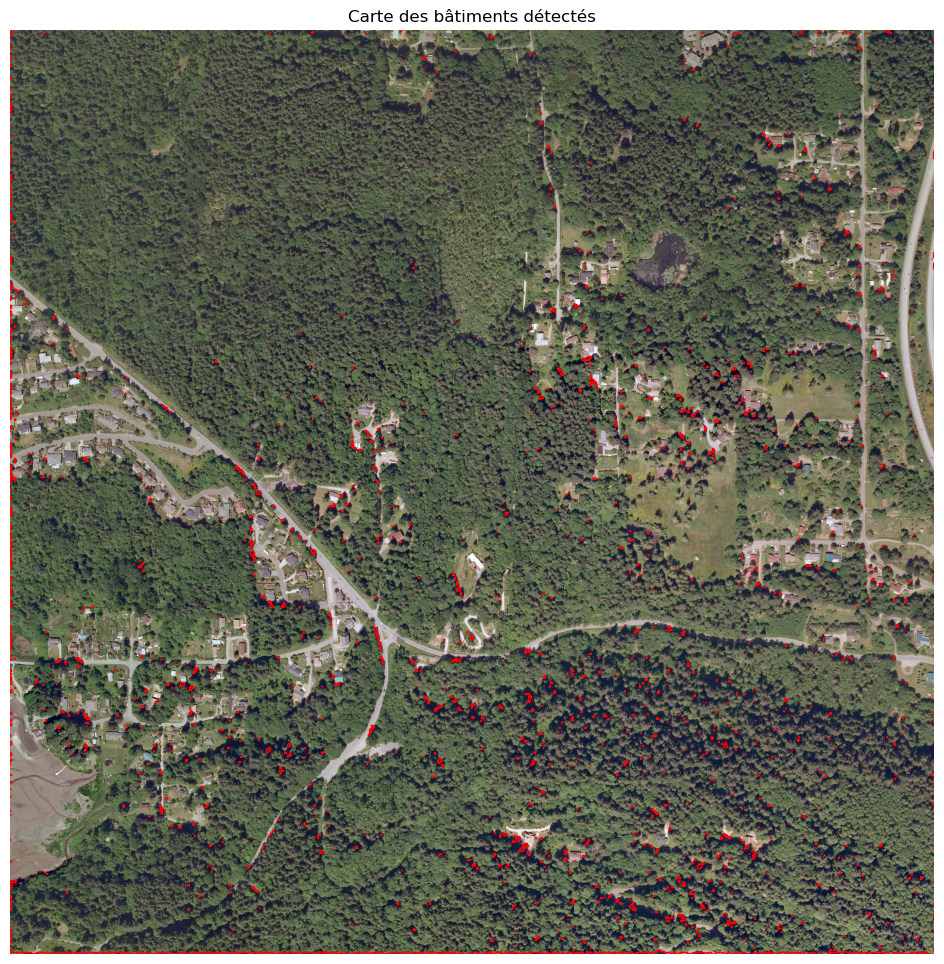

Carte DXF créée : D:\oujda\AerialImageDataset\test\images\bellingham4.dxf
Traitement terminé avec succès.
Début du traitement pour : D:\oujda\AerialImageDataset\test\images\bellingham5.tif
1/1 [==============================] - 2s 2s/step
Nombre de géométries créées : 2024


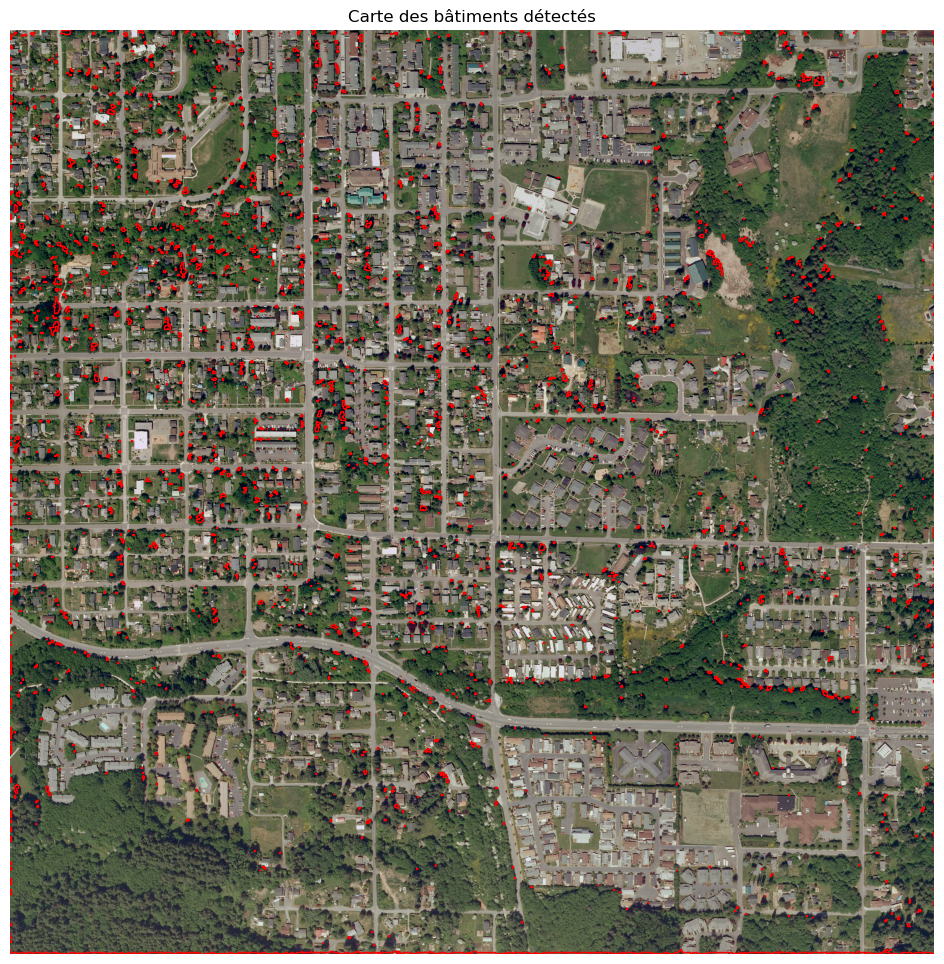

Carte DXF créée : D:\oujda\AerialImageDataset\test\images\bellingham5.dxf
Traitement terminé avec succès.
Début du traitement pour : D:\oujda\AerialImageDataset\test\images\bellingham6.tif
1/1 [==============================] - 1s 1s/step
Nombre de géométries créées : 1317


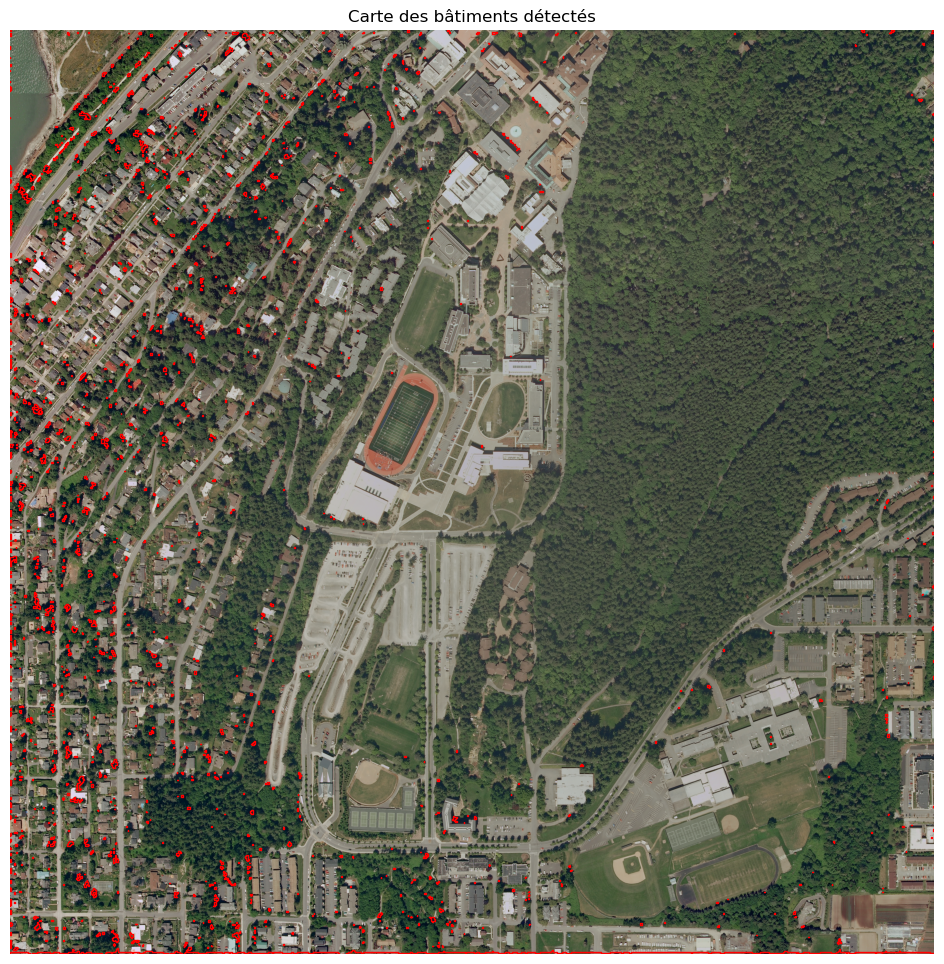

Carte DXF créée : D:\oujda\AerialImageDataset\test\images\bellingham6.dxf
Traitement terminé avec succès.
Début du traitement pour : D:\oujda\AerialImageDataset\test\images\bellingham7.tif
1/1 [==============================] - 1s 1s/step
Nombre de géométries créées : 1582


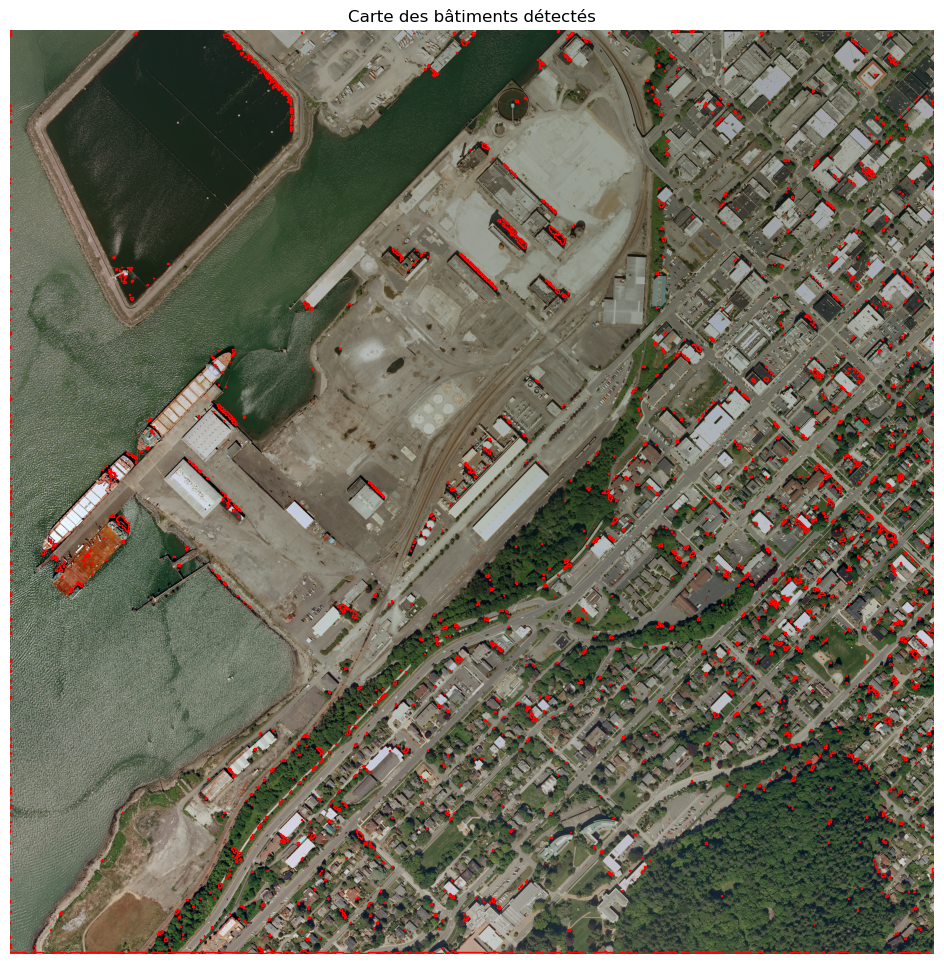

Carte DXF créée : D:\oujda\AerialImageDataset\test\images\bellingham7.dxf
Traitement terminé avec succès.
Début du traitement pour : D:\oujda\AerialImageDataset\test\images\bellingham8.tif
1/1 [==============================] - 1s 1s/step
Nombre de géométries créées : 967


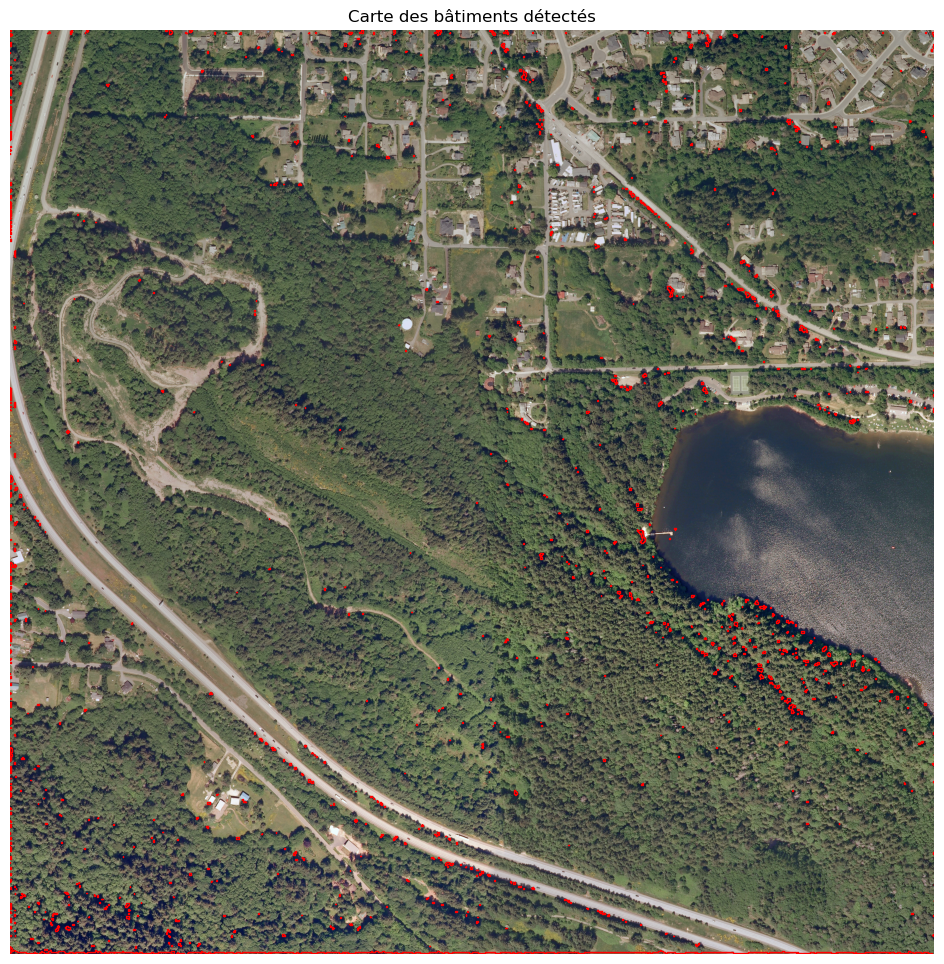

Carte DXF créée : D:\oujda\AerialImageDataset\test\images\bellingham8.dxf
Traitement terminé avec succès.
Début du traitement pour : D:\oujda\AerialImageDataset\test\images\bellingham9.tif
1/1 [==============================] - 1s 1s/step
Nombre de géométries créées : 1034


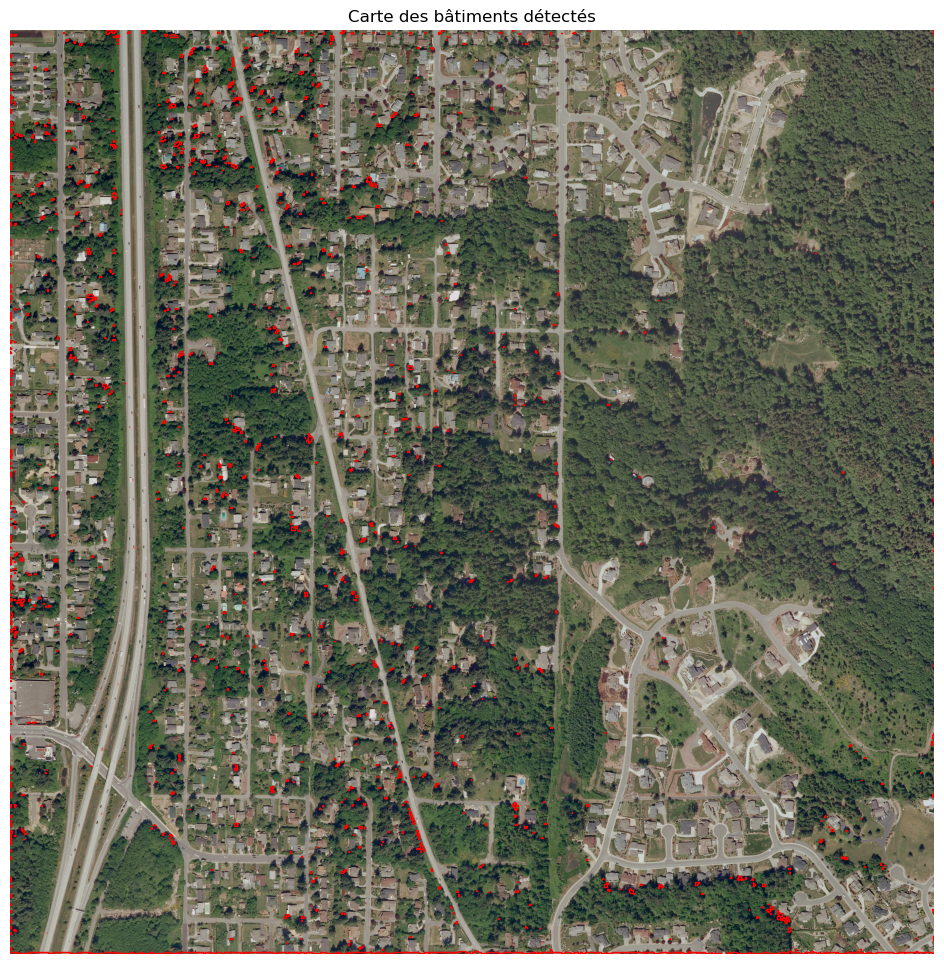

Carte DXF créée : D:\oujda\AerialImageDataset\test\images\bellingham9.dxf
Traitement terminé avec succès.


In [6]:
if __name__ == "__main__":
    # Charger les images et les masques
    images = load_and_resize_images(train_images_dir)
    masks = load_and_resize_images(train_masks_dir, color_mode='grayscale')

    # Normaliser les images et les masques
    images = images.astype('float32') / 255.0
    masks = masks.astype('float32') / 255.0

    # Diviser les données en ensembles d'entraînement et de validation
    X_train, X_val, y_train, y_val = train_test_split(images, masks, test_size=0.2, random_state=42)

    # Initialiser le modèle U-Net
    model = unet()

    # Définir le point de contrôle pour enregistrer le meilleur modèle
    checkpoint_path = r"D:\oujda\model_checkpoint.keras"
    checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_dice_coef', verbose=1, save_best_only=True, mode='max')

    # Entraîner le modèle
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), batch_size=4, epochs=2,
                        callbacks=[checkpoint])

    # Charger le meilleur modèle
    model.load_weights(checkpoint_path)

    # Faire des prédictions et créer des cartes DXF pour chaque image de test
    test_images_dir = r'D:\oujda\AerialImageDataset\test\images'
    for filename in os.listdir(test_images_dir):
        if filename.endswith(".tif"):
            image_path = os.path.join(test_images_dir, filename)
            predict_and_create_map(model, image_path)